In [2]:
DEBUG = False

In [3]:
import sys
sys.path.append('../HPA-competition-solutions/bestfitting/src/')

In [4]:
import time
import skimage.io
import numpy as np
import pandas as pd
import cv2
import PIL.Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SubsetRandomSampler, RandomSampler, SequentialSampler
from warmup_scheduler import GradualWarmupScheduler
from efficientnet_pytorch import model as enet
import albumentations
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import cohen_kappa_score
from tqdm import tqdm_notebook as tqdm
import os
import warnings
import cv2
from sklearn.metrics import average_precision_score
import pickle

warnings.filterwarnings('ignore') 

In [5]:
from config.config import *
from networks.densenet import *
from datasets.tool import *
from torch.utils.data import Dataset
import pandas as pd
import torchvision
import torch
import cv2
import os

import time
import shutil
from sklearn.metrics import f1_score

import torch
import torch.optim
from torch.utils.data import DataLoader
from torch.utils.data.sampler import RandomSampler, SequentialSampler
from torch.nn import DataParallel
from torch.backends import cudnn
import torch.nn.functional as F
from torch.autograd import Variable

from config.config import *
from utils.common_util import *
from networks.imageclsnet import init_network
from datasets.protein_dataset import ProteinDataset
from utils.augment_util import train_multi_augment2
from layers.loss import *
from layers.scheduler import *
from utils.log_util import Logger

run on pazur


In [6]:
kernel_type = 'bf_6'

fold = 0
image_size = 768
crop_size = 512
batch_size = 64
num_workers = 8
out_dim = 19
init_lr = 3e-4
warmup_factor = 10
nseed = 2 if DEBUG else 5
nfold = 2 if DEBUG else 5
seed = 42
test_image_size = 128

warmup_epo = 1
n_epochs = 3 if DEBUG else 6

device = torch.device('cuda')

In [7]:
df = pd.read_csv('../hpa_folds_v1.csv')

In [8]:
train_folder = '/media/darek/projects/hpa/train768'
public__folder = '/media/darek/projects/hpa/public768/hpa_public_excl_0_16_768/small'

df_t = df[df.dataset == 'train']
df_p = df[df.dataset == 'public']
df_t['fpath'] = df_t.ID.apply(lambda r: os.path.join(train_folder, r))
df_p['fpath'] = df_p.ID.apply(lambda r: os.path.join(public__folder, r))

df_train = pd.concat([df_t, df_p], ignore_index=True)
df_train.drop_duplicates(inplace=True)
df_train.reset_index(drop=True, inplace=True)
df_train['Label'] = df_train['Label'].astype(str)
df_train.head()

,ID,Label,dataset,fold,fpath
0,12d0e1dc-bbc7-11e8-b2bc-ac1f6b6435d0,14,train,4,/media/darek/projects/hpa/train768/12d0e1dc-bb...
1,836a3fb4-bba5-11e8-b2ba-ac1f6b6435d0,14,train,0,/media/darek/projects/hpa/train768/836a3fb4-bb...
2,5a474b22-bba5-11e8-b2ba-ac1f6b6435d0,5,train,1,/media/darek/projects/hpa/train768/5a474b22-bb...
3,a2a59eea-bba6-11e8-b2ba-ac1f6b6435d0,2,train,0,/media/darek/projects/hpa/train768/a2a59eea-bb...
4,d6118772-bba5-11e8-b2ba-ac1f6b6435d0,16|10|13,train,0,/media/darek/projects/hpa/train768/d6118772-bb...


In [9]:
df_train = df_train.sample(256).reset_index(drop=True) if DEBUG else df_train

In [10]:
labels = [str(i) for i in range(19)]
full_counts = {}
fsum = 0
for lbl in labels:
    count = 0
    for row_label in df_train['Label']:
        if lbl in row_label.split('|'): count += 1
    full_counts[lbl] = count
    fsum += count
full_counts['avg'] = int(fsum/(len(labels)))

counts = list(zip(full_counts.keys(), full_counts.values()))
counts = np.array(sorted(counts, key=lambda x:-x[1]))
counts = pd.DataFrame(counts, columns=['label', 'full_count'])
counts.set_index('label', inplace=True)
counts.T

label,0,17,13,14,16,18,7,2,avg,4,5,12,6,3,9,1,10,8,15,11
full_count,8797,6733,6443,6164,5685,5318,4381,3989,3503,3204,2593,2593,2219,1845,1682,1607,1543,1320,312,141


## Model

In [11]:
dm = torchvision.models.densenet121(pretrained=True)

In [12]:
def get_model(n):
    
    model_file = f'/home/darek/Projects/HPA/protein_models/models/external_crop512_focal_slov_hardlog_class_densenet121_dropout_i768_aug2_5folds/fold{n}/final.pth'

    model = class_densenet121_dropout(num_classes=19, in_channels=4, pretrained_file='/home/darek/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth')
    weights = torch.load(model_file)
    pretrained_dict = weights['state_dict']
    model_dict = model.state_dict()

    # 1. filter out unnecessary keys
    pretrained_dict = {k: v for k, v in pretrained_dict.items() if k not in ['logit.weight', 'logit.bias']}
    # 2. overwrite entries in the existing state dict
    model_dict.update(pretrained_dict)
    # 3. load the new state dict
    model.load_state_dict(model_dict)

    i = 0
    for child in model.children():
        if i < 6:
            for param in child.parameters():
                param.requires_grad = False
        i += 1
    return model

In [13]:
def get_model_test():
    model = class_densenet121_dropout(num_classes=19, in_channels=4, pretrained_file='/home/darek/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth')
    return model

In [14]:
def open_rgby(fpath, yellow=True): #a function that reads RGBY image    
    if yellow: colors = ['red','green','blue','yellow']
    else: colors = ['red','green','blue']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(fpath+'_'+color+'.png', flags) for color in colors]
    
    return np.stack(img, axis=-1)

## Dataset

In [15]:
class HPADataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        fpath = row.fpath
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255 #moved to albumentations normalize
        image = image.transpose(2, 0, 1)

        label = np.zeros(out_dim).astype(np.float32)
        img_lbls = [int(x) for x in row.Label.split('|')]
        for i in img_lbls: label[i] = 1.
        return torch.tensor(image), torch.tensor(label)

## Augmentations

In [16]:
from albumentations.core.transforms_interface import ImageOnlyTransform

class Gridify(ImageOnlyTransform):

    def __init__(
        self,
        grid_size=2048,
        always_apply=False,
        p=1.0,
    ):
        super(Gridify, self).__init__(always_apply, p)
        self.grid_size = grid_size
        self.transform = albumentations.Compose([
            albumentations.VerticalFlip(p=0.5),
            albumentations.HorizontalFlip(p=0.5),
        ])

    def apply(self, image, **params):
        grid = np.zeros((self.grid_size,self.grid_size, 4)).astype(np.uint8)
        ch,cw,_ = image.shape
        gh,gw,_ = grid.shape
        hsteps = np.ceil(gh/ch).astype(int)
        wsteps = np.ceil(gw/cw).astype(int)

        h,w = ch,cw
        hmargin = ch

        for i in range(hsteps):
            wmargin = cw
            h = ch * (i+1)
            if h > gh:
                hmargin = gh-h
                h = gh
            for j in range(wsteps):
                transformed = self.transform(image=image)
                transformed_image = transformed["image"]
                w = cw * (j+1)
                if w > gw:
                    wmargin = gw-w
                    w = gw
                grid[ch*i:h,cw*j:w,:] = transformed_image[:hmargin,:wmargin,:]
        return grid        

    def get_transform_init_args_names(self):
        return ("grid_size")

In [17]:
mean = (0.07237246, 0.04476176, 0.07661699)
std = (0.17179589, 0.10284516, 0.14199627)


transforms_train = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
    albumentations.RandomCrop(crop_size, crop_size, p=1.),
    albumentations.VerticalFlip(p=0.5),
    albumentations.HorizontalFlip(p=0.5),
    albumentations.RandomRotate90(p=0.5),
])

transforms_val = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
    albumentations.RandomCrop(crop_size, crop_size, p=1.),
])

transforms_test = albumentations.Compose([
    albumentations.LongestMaxSize(max_size=int(test_image_size)),
    albumentations.PadIfNeeded(min_height=int(test_image_size * 1.25), min_width=int(test_image_size * 1.25)),
])

transforms_grid1 = albumentations.Compose([
    Gridify(grid_size=2048),
    albumentations.Resize(image_size, image_size, p=1.),
])
transforms_grid2 = albumentations.Compose([
    Gridify(grid_size=1728),
    albumentations.Resize(image_size, image_size, p=1.),
])
transforms_grid3 = albumentations.Compose([
    Gridify(grid_size=3072),
    albumentations.Resize(image_size, image_size, p=1.),
])

In [19]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std
    def __call__(self, tensor):
        return tensor

In [20]:
def tensor2label(t):
    l = t.numpy().tolist()
    l = [i for i,v in enumerate(l) if v==1.]
    return str(l)
label = torch.tensor(np.array([1.,0,1,0]))
tensor2label(label)

'[0, 2]'

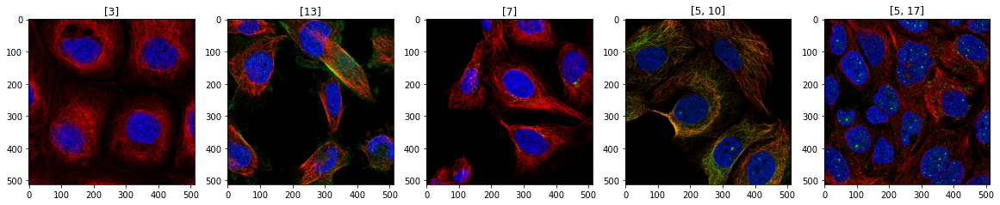

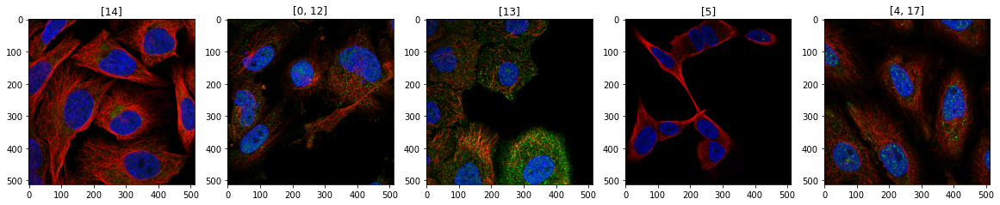

In [21]:
unnorm = UnNormalize(mean, std)
dataset_show = HPADataset(df_train, transform=transforms_train)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img, label = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[p].set_title(tensor2label(label))


## Loss

In [22]:
class FocalLoss(nn.Module):
    def __init__(self, gamma=2):
        super().__init__()
        self.gamma = gamma
        
    def forward(self, inputs, target):
        if not (target.size() == inputs.size()):
            raise ValueError("Target size ({}) must be the same as input size ({})"
                             .format(target.size(), input.size()))

        max_val = (-inputs).clamp(min=0)
        loss = inputs - inputs * target + max_val + \
            ((-max_val).exp() + (-inputs - max_val).exp()).log()

        invprobs = F.logsigmoid(-inputs * (target * 2.0 - 1.0))
        loss = (invprobs * self.gamma).exp() * loss
        
        return loss.sum(dim=1).mean()

In [23]:
criterion = FocalSymmetricLovaszHardLogLoss().cuda()
focal = FocalLoss().cuda()

## Train and Val

In [24]:
def train_epoch(loader, optimizer, scaler):

    model.train()
    train_loss = []
    bar = tqdm(loader)
    for (data, target) in bar:
        
        data, target = data.to(device), target.to(device)
        loss_func = criterion
        optimizer.zero_grad()
        
        with torch.cuda.amp.autocast():
            logits = model(data)
            loss = loss_func(logits, target)
            
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        loss_np = loss.detach().cpu().numpy()
        train_loss.append(loss_np)
        smooth_loss = sum(train_loss[-100:]) / min(len(train_loss), 100)
        bar.set_description('loss: %.5f, smth: %.5f' % (loss_np, smooth_loss))
    return train_loss


def val_epoch(loader, get_output=False):

    model.eval()
    val_loss = []
    val_focal = []
    LOGITS = []
    PREDS = []
    TARGETS = []

    with torch.no_grad():
        for (data, target) in tqdm(loader):
            data, target = data.to(device), target.to(device)
            logits = model(data)
            loss = criterion(logits, target)
            foc = focal(logits, target)
            pred = logits.sigmoid().detach()
            LOGITS.append(logits)
            PREDS.append(pred)
            TARGETS.append(target)
            val_loss.append(loss.detach().cpu().numpy())
            val_focal.append(foc.detach().cpu().numpy())         

        val_loss = np.mean(val_loss)
        val_focal = np.mean(val_focal)

    LOGITS = torch.cat(LOGITS).cpu().numpy()
    PREDS = torch.cat(PREDS).cpu().numpy()
    TARGETS = torch.cat(TARGETS).cpu().numpy()
    
    average_precision = dict()
    for i in range(out_dim):
        average_precision[i] = average_precision_score(TARGETS[:, i], PREDS[:, i])
    average_precision["macro"] = average_precision_score(TARGETS, PREDS, average="macro")
    
    print('Average precision:')
    print(average_precision)

    if get_output:
        return LOGITS
    else:
        return val_loss, val_focal, average_precision["macro"], average_precision

## Run Training

In [25]:
checkpoints = []

for fold in range(nfold):
    seed = fold
    print('#'*60)
    print(f'Training fold {fold}')
    print('#'*60)

    train_idx = np.where((df_train['fold'] != fold))[0]
    valid_idx = np.where((df_train['fold'] == fold))[0]

    df_this  = df_train.loc[train_idx]
    df_valid = df_train.loc[valid_idx]

    dataset_train = HPADataset(df_this, transform=transforms_train)
    dataset_valid = HPADataset(df_valid, transform=transforms_val)

    train_loader = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, sampler=RandomSampler(dataset_train), num_workers=num_workers)
    valid_loader = torch.utils.data.DataLoader(dataset_valid, batch_size=batch_size, sampler=SequentialSampler(dataset_valid), num_workers=num_workers)

    model = get_model(seed)
    model = model.to(device)

    scaler = torch.cuda.amp.GradScaler()

    optimizer = optim.Adam(model.parameters(), lr=init_lr)
    scheduler = lr_scheduler.CosineAnnealingLR(optimizer, n_epochs, eta_min=2e-5)

    print(len(dataset_train), len(dataset_valid))

    for epoch in range(1, n_epochs+1):
        print(time.ctime(), 'Epoch:', epoch)
        checkpoint_file = f'{kernel_type}_model_seed_{seed}_fold_{fold}_epoch_{epoch}.pth'

        if epoch == 2:
            for param in model.parameters():
                param.requires_grad = True
            print('Unfreezing!')
            optimizer = optim.Adam(model.parameters(), lr=init_lr/10)
            scheduler = lr_scheduler.CosineAnnealingLR(optimizer, n_epochs, eta_min=1e-5)

        train_loss = train_epoch(train_loader, optimizer, scaler)
        val_loss, val_focal, aps, apsdict = val_epoch(valid_loader)
        scheduler.step()

        content = time.ctime() + ' ' + f'Epoch {epoch}, lr: {optimizer.param_groups[0]["lr"]:.7f}, train loss: {np.mean(train_loss):.5f}, val loss: {np.mean(val_loss):.5f}, aps: {(aps):.5f}'
        print(content)
        with open(f'log_{kernel_type}.txt', 'a') as appender:
            appender.write(content + '\n')

        torch.save(model.state_dict(), checkpoint_file)

        res = {
            'checkpoint': checkpoint_file,
            'val_loss': val_loss,
            'val_focal': val_focal,
            'aps': aps,
            'aps_dict': apsdict,
            'seed': seed,
            'fold': fold,
            'epoch': epoch,
        }
        checkpoints.append(res)
            

############################################################
Training fold 0
############################################################
38630 10242
Sat Apr 17 01:01:19 2021 Epoch: 1


  0%|          | 0/604 [00:00<?, ?it/s]

  0%|          | 0/161 [00:00<?, ?it/s]

Average precision:
{0: 0.9257386902738679, 1: 0.9330457884564971, 2: 0.9127169156360163, 3: 0.8690975078861097, 4: 0.9509356366199596, 5: 0.8568806674746643, 6: 0.8559301875494431, 7: 0.9209406658419271, 8: 0.9107705102795505, 9: 0.8796765339994165, 10: 0.9709471969817552, 11: 0.45541977895914276, 12: 0.8347179824588419, 13: 0.8933464983040873, 14: 0.9623897043088758, 15: 0.7461155017697021, 16: 0.7350597221569377, 17: 0.8513733791012041, 18: 0.9162797800775591, 'macro': 0.8621780341123979}
Sat Apr 17 01:05:15 2021 Epoch 1, lr: 0.0002812, train loss: 0.66625, val loss: 0.44584, aps: 0.86218
Sat Apr 17 01:05:15 2021 Epoch: 2
Unfreezing!


  0%|          | 0/604 [00:00<?, ?it/s]

  0%|          | 0/161 [00:00<?, ?it/s]

Average precision:
{0: 0.929844105066242, 1: 0.9444105740177856, 2: 0.9212681745593361, 3: 0.8818317426382346, 4: 0.9560970104315387, 5: 0.8671350676356402, 6: 0.8608519185674164, 7: 0.9224764290635475, 8: 0.9152094173142208, 9: 0.8820429385403402, 10: 0.9706428008286081, 11: 0.5235506447997338, 12: 0.8314444161755628, 13: 0.8963493386866678, 14: 0.9681790853452417, 15: 0.7936536182748362, 16: 0.7614684437404314, 17: 0.8836109890672967, 18: 0.9357927398420064, 'macro': 0.8760978660312992}
Sat Apr 17 01:14:58 2021 Epoch 2, lr: 0.0000287, train loss: 0.47425, val loss: 0.41789, aps: 0.87610
Sat Apr 17 01:14:58 2021 Epoch: 3


  0%|          | 0/604 [00:00<?, ?it/s]

  0%|          | 0/161 [00:00<?, ?it/s]

Average precision:
{0: 0.93132666788775, 1: 0.9451342161797778, 2: 0.919481202363239, 3: 0.883153689917346, 4: 0.9603527723833165, 5: 0.8604430977234641, 6: 0.8682069647745903, 7: 0.9250396138589649, 8: 0.9081869306437449, 9: 0.8895038680549483, 10: 0.9712797980801889, 11: 0.5739941812873827, 12: 0.8429814972615686, 13: 0.9020448513689822, 14: 0.9686420830294797, 15: 0.7555893760097763, 16: 0.7752128669143694, 17: 0.8857845527938326, 18: 0.9393523409793144, 'macro': 0.8792479248164229}
Sat Apr 17 01:24:42 2021 Epoch 3, lr: 0.0000250, train loss: 0.45412, val loss: 0.41061, aps: 0.87925
Sat Apr 17 01:24:42 2021 Epoch: 4


  0%|          | 0/604 [00:00<?, ?it/s]

  0%|          | 0/161 [00:00<?, ?it/s]

Average precision:
{0: 0.9326707917496299, 1: 0.9449386762031733, 2: 0.922675251610988, 3: 0.8907938579105962, 4: 0.9576306578595665, 5: 0.8669437851088605, 6: 0.8724368406146722, 7: 0.9251694650687724, 8: 0.9294181857816569, 9: 0.8854173356927427, 10: 0.9692833022149949, 11: 0.5874883816822115, 12: 0.8484498116659361, 13: 0.9019559531995744, 14: 0.9691363697197551, 15: 0.8050124555570991, 16: 0.7786163874587742, 17: 0.891968049743234, 18: 0.942654841786059, 'macro': 0.8854031789804367}
Sat Apr 17 01:34:26 2021 Epoch 4, lr: 0.0000200, train loss: 0.44583, val loss: 0.39994, aps: 0.88540
Sat Apr 17 01:34:26 2021 Epoch: 5


  0%|          | 0/604 [00:00<?, ?it/s]

  0%|          | 0/161 [00:00<?, ?it/s]

Average precision:
{0: 0.9336674390060302, 1: 0.9422004485733312, 2: 0.9243186241963912, 3: 0.8790332633007072, 4: 0.95947182477755, 5: 0.8788304095719214, 6: 0.8683051370060192, 7: 0.9254534484920001, 8: 0.9139870801349063, 9: 0.8887158408498044, 10: 0.9704999795385859, 11: 0.5667350731444655, 12: 0.8493695199799162, 13: 0.9035235749741377, 14: 0.9674631738535308, 15: 0.746356280712826, 16: 0.7820999574401843, 17: 0.8957569867579392, 18: 0.9461921045005675, 'macro': 0.8811568508847798}
Sat Apr 17 01:44:10 2021 Epoch 5, lr: 0.0000150, train loss: 0.43922, val loss: 0.39841, aps: 0.88116
Sat Apr 17 01:44:10 2021 Epoch: 6


  0%|          | 0/604 [00:00<?, ?it/s]

  0%|          | 0/161 [00:00<?, ?it/s]

Average precision:
{0: 0.9358373714358782, 1: 0.9469782120033965, 2: 0.9292470008889754, 3: 0.880732048448843, 4: 0.9613792931478254, 5: 0.8668661436221623, 6: 0.8689007577557646, 7: 0.9266728129082873, 8: 0.9140993432609243, 9: 0.8947710761176164, 10: 0.9682455048452512, 11: 0.6276362145655098, 12: 0.8385262457922931, 13: 0.9057510097398908, 14: 0.968597902279988, 15: 0.7953237408360431, 16: 0.7797616563849167, 17: 0.8979696767336682, 18: 0.9451975761627617, 'macro': 0.8869733466805261}
Sat Apr 17 01:53:54 2021 Epoch 6, lr: 0.0000113, train loss: 0.43171, val loss: 0.39661, aps: 0.88697
############################################################
Training fold 1
############################################################
39114 9758
Sat Apr 17 01:53:54 2021 Epoch: 1


  0%|          | 0/612 [00:00<?, ?it/s]

  0%|          | 0/153 [00:00<?, ?it/s]

Average precision:
{0: 0.9248228757594208, 1: 0.9455101090658851, 2: 0.9196449446882073, 3: 0.9107415252548492, 4: 0.9520136717340828, 5: 0.8575176277445984, 6: 0.8383830925122404, 7: 0.9166139006670804, 8: 0.8866752514940998, 9: 0.8635639433370473, 10: 0.9782408135840504, 11: 0.47616010209078324, 12: 0.8420689210119491, 13: 0.8752523051335821, 14: 0.9574737247724385, 15: 0.6853228318398764, 16: 0.7761435006100683, 17: 0.82667004994719, 18: 0.9255858947719023, 'macro': 0.8609686887378607}
Sat Apr 17 01:57:34 2021 Epoch 1, lr: 0.0002812, train loss: 0.66446, val loss: 0.44631, aps: 0.86097
Sat Apr 17 01:57:34 2021 Epoch: 2
Unfreezing!


  0%|          | 0/612 [00:00<?, ?it/s]

  0%|          | 0/153 [00:00<?, ?it/s]

Average precision:
{0: 0.9323605029810911, 1: 0.9458031792125874, 2: 0.9215617452819569, 3: 0.9194756512280461, 4: 0.961242694733173, 5: 0.8706622704583298, 6: 0.8491907204010005, 7: 0.9275458064800184, 8: 0.9115719784625407, 9: 0.8710916500537663, 10: 0.9838943504494275, 11: 0.5149522503009135, 12: 0.8512452145654127, 13: 0.8854018705817789, 14: 0.9630954062865601, 15: 0.6670954172670627, 16: 0.7851452413754242, 17: 0.8571033530830674, 18: 0.9399074832506201, 'macro': 0.8714919361290935}
Sat Apr 17 02:07:22 2021 Epoch 2, lr: 0.0000287, train loss: 0.47369, val loss: 0.41866, aps: 0.87149
Sat Apr 17 02:07:22 2021 Epoch: 3


  0%|          | 0/612 [00:00<?, ?it/s]

  0%|          | 0/153 [00:00<?, ?it/s]

Average precision:
{0: 0.9322201525749614, 1: 0.9437999700718983, 2: 0.9221032327538131, 3: 0.922368745454665, 4: 0.9622011559086517, 5: 0.8802855104440566, 6: 0.8524773494159474, 7: 0.9270432644419678, 8: 0.902250281000911, 9: 0.866747815445016, 10: 0.9836853444845277, 11: 0.44573066998890865, 12: 0.8638655127719144, 13: 0.8913936535758578, 14: 0.9624959897650478, 15: 0.6957087098165988, 16: 0.7983940287133809, 17: 0.8626748440930425, 18: 0.9450302132816729, 'macro': 0.8716040233685706}
Sat Apr 17 02:17:09 2021 Epoch 3, lr: 0.0000250, train loss: 0.45332, val loss: 0.40737, aps: 0.87160
Sat Apr 17 02:17:09 2021 Epoch: 4


  0%|          | 0/612 [00:00<?, ?it/s]

  0%|          | 0/153 [00:00<?, ?it/s]

Average precision:
{0: 0.9334940771344613, 1: 0.9453289602850447, 2: 0.9215367695204485, 3: 0.9203994558605038, 4: 0.9617387438681846, 5: 0.8704037604231251, 6: 0.8565931340362695, 7: 0.9287808575895422, 8: 0.9087563478062527, 9: 0.872401441690861, 10: 0.9861935987126328, 11: 0.39412186814567135, 12: 0.8621628078368503, 13: 0.8927492799336646, 14: 0.9651764467929216, 15: 0.6648249158919718, 16: 0.7986127961622976, 17: 0.864449098172174, 18: 0.9490756283828854, 'macro': 0.8682526309603033}
Sat Apr 17 02:26:57 2021 Epoch 4, lr: 0.0000200, train loss: 0.44335, val loss: 0.40627, aps: 0.86825
Sat Apr 17 02:26:57 2021 Epoch: 5


  0%|          | 0/612 [00:00<?, ?it/s]

  0%|          | 0/153 [00:00<?, ?it/s]

Average precision:
{0: 0.9341912529027058, 1: 0.9443726037601778, 2: 0.9230550996861795, 3: 0.9184269996985464, 4: 0.9625516319365186, 5: 0.877066170269631, 6: 0.8565206203933609, 7: 0.9280023626475981, 8: 0.9179955900432755, 9: 0.8812711237075934, 10: 0.9844075059530973, 11: 0.49694748039978753, 12: 0.8586850837871978, 13: 0.8951641301684344, 14: 0.9658879660995797, 15: 0.6779830938909797, 16: 0.79908149778789, 17: 0.8670040807554973, 18: 0.9430563742637754, 'macro': 0.8753510877974646}
Sat Apr 17 02:36:45 2021 Epoch 5, lr: 0.0000150, train loss: 0.43465, val loss: 0.40414, aps: 0.87535
Sat Apr 17 02:36:45 2021 Epoch: 6


  0%|          | 0/612 [00:00<?, ?it/s]

  0%|          | 0/153 [00:00<?, ?it/s]

Average precision:
{0: 0.9360700930804506, 1: 0.9452200139905894, 2: 0.9273768170657771, 3: 0.9133436878161755, 4: 0.9643321782238602, 5: 0.8768725393373474, 6: 0.8570636088418844, 7: 0.9272709385338974, 8: 0.9043936822744764, 9: 0.877156005360265, 10: 0.9851917230723276, 11: 0.4480967714493629, 12: 0.8548542307368244, 13: 0.8920847252241395, 14: 0.9649551356135442, 15: 0.6650947013405034, 16: 0.7950260387304942, 17: 0.8699175140024547, 18: 0.9500901254069897, 'macro': 0.8712847647421771}
Sat Apr 17 02:46:32 2021 Epoch 6, lr: 0.0000113, train loss: 0.42934, val loss: 0.40289, aps: 0.87128
############################################################
Training fold 2
############################################################
39001 9871
Sat Apr 17 02:46:32 2021 Epoch: 1


  0%|          | 0/610 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

Average precision:
{0: 0.9174291057183648, 1: 0.9580076254950631, 2: 0.9077858416152457, 3: 0.8894320350056334, 4: 0.9501803470806365, 5: 0.8128453305975654, 6: 0.876192982822768, 7: 0.9135650407981201, 8: 0.920500879148188, 9: 0.8819408371682358, 10: 0.9709001917110931, 11: 0.47129668562202875, 12: 0.8305539232698563, 13: 0.8652864827932628, 14: 0.9558033617011903, 15: 0.7688288885854268, 16: 0.7615590799791062, 17: 0.8561219259641613, 18: 0.9273308866208636, 'macro': 0.8650295500893059}
Sat Apr 17 02:50:15 2021 Epoch 1, lr: 0.0002812, train loss: 0.66548, val loss: 0.44844, aps: 0.86503
Sat Apr 17 02:50:15 2021 Epoch: 2
Unfreezing!


  0%|          | 0/610 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

Average precision:
{0: 0.9237561846744068, 1: 0.9556372281681069, 2: 0.9111092492016849, 3: 0.8942827421972739, 4: 0.9583154632158813, 5: 0.8128086510523659, 6: 0.8841399700025363, 7: 0.9190341314801758, 8: 0.9272727400194132, 9: 0.8844674874715417, 10: 0.9683541261497483, 11: 0.5561511619787891, 12: 0.8331745468095159, 13: 0.8716739866825444, 14: 0.9617698240187228, 15: 0.7850423671074226, 16: 0.7842963060391981, 17: 0.8845305871536282, 18: 0.9410659718830221, 'macro': 0.8766780381739989}
Sat Apr 17 03:00:03 2021 Epoch 2, lr: 0.0000287, train loss: 0.47300, val loss: 0.42465, aps: 0.87668
Sat Apr 17 03:00:03 2021 Epoch: 3


  0%|          | 0/610 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

Average precision:
{0: 0.9255702941240658, 1: 0.9591558345835501, 2: 0.9138621109924299, 3: 0.893578497644438, 4: 0.9639247561805235, 5: 0.8203528947801814, 6: 0.8860131220982863, 7: 0.9190785304610711, 8: 0.9284978930242308, 9: 0.886434985697786, 10: 0.9723247015852304, 11: 0.5404169467898158, 12: 0.8361569773841325, 13: 0.8714842818189082, 14: 0.962578304348854, 15: 0.7987160786486979, 16: 0.797443052437291, 17: 0.8919397070368497, 18: 0.9425360702939938, 'macro': 0.8794771073647546}
Sat Apr 17 03:09:50 2021 Epoch 3, lr: 0.0000250, train loss: 0.45630, val loss: 0.41576, aps: 0.87948
Sat Apr 17 03:09:50 2021 Epoch: 4


  0%|          | 0/610 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

Average precision:
{0: 0.9290578602805216, 1: 0.9563033518887586, 2: 0.9164877716870333, 3: 0.9021099732865083, 4: 0.9579310819158141, 5: 0.8243244100275723, 6: 0.8881625576695412, 7: 0.9183793940633338, 8: 0.9338913001264517, 9: 0.8803272872903175, 10: 0.9731224734938396, 11: 0.6070445494934145, 12: 0.844937728964158, 13: 0.8777694390228715, 14: 0.9608105378667426, 15: 0.7930221269882083, 16: 0.7984596671727845, 17: 0.8939036383758174, 18: 0.9450154666539162, 'macro': 0.8842663482246108}
Sat Apr 17 03:19:38 2021 Epoch 4, lr: 0.0000200, train loss: 0.44463, val loss: 0.41022, aps: 0.88427
Sat Apr 17 03:19:38 2021 Epoch: 5


  0%|          | 0/610 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

Average precision:
{0: 0.9289862904565532, 1: 0.9585331227033151, 2: 0.9129544585736818, 3: 0.8958106425604505, 4: 0.9620378281296579, 5: 0.8234583855079298, 6: 0.8882102119298685, 7: 0.9226677527769854, 8: 0.9408068186647659, 9: 0.893321496503306, 10: 0.9738428556511236, 11: 0.5901625119216695, 12: 0.8417898835666769, 13: 0.8807658388644607, 14: 0.962137814570763, 15: 0.7584375957491211, 16: 0.8025354351834789, 17: 0.8971482070383016, 18: 0.9500653526909957, 'macro': 0.8833511843706896}
Sat Apr 17 03:29:25 2021 Epoch 5, lr: 0.0000150, train loss: 0.43902, val loss: 0.40491, aps: 0.88335
Sat Apr 17 03:29:25 2021 Epoch: 6


  0%|          | 0/610 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

Average precision:
{0: 0.9279993416750948, 1: 0.9611834214057148, 2: 0.9136857621969485, 3: 0.8935227606625608, 4: 0.9625103096671853, 5: 0.8247168512385326, 6: 0.8893590001517022, 7: 0.9229455407316195, 8: 0.935797930445537, 9: 0.8889690018634577, 10: 0.9700798936436327, 11: 0.579370890528176, 12: 0.8389060379744607, 13: 0.8785356647543537, 14: 0.9627949518436338, 15: 0.7861481625358089, 16: 0.8063915207518622, 17: 0.8965281472971374, 18: 0.9485166375607446, 'macro': 0.8835769382593771}
Sat Apr 17 03:39:12 2021 Epoch 6, lr: 0.0000113, train loss: 0.43454, val loss: 0.40584, aps: 0.88358
############################################################
Training fold 3
############################################################
39256 9616
Sat Apr 17 03:39:13 2021 Epoch: 1


  0%|          | 0/614 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

Average precision:
{0: 0.9126288612252625, 1: 0.9618499735031866, 2: 0.905797208105018, 3: 0.8897045024875073, 4: 0.9598243600096268, 5: 0.8246023661819953, 6: 0.8788265848584194, 7: 0.8914110356363252, 8: 0.9028872101295764, 9: 0.8766095432569856, 10: 0.9680876633356343, 11: 0.5986177842748819, 12: 0.8334395973263055, 13: 0.8697424674410021, 14: 0.9569221140565114, 15: 0.7572345404374137, 16: 0.7778664982578888, 17: 0.8384906388563466, 18: 0.9202236072527715, 'macro': 0.8697245556122453}
Sat Apr 17 03:42:54 2021 Epoch 1, lr: 0.0002812, train loss: 0.65921, val loss: 0.44580, aps: 0.86972
Sat Apr 17 03:42:55 2021 Epoch: 2
Unfreezing!


  0%|          | 0/614 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

Average precision:
{0: 0.9212806119235174, 1: 0.9583486634109087, 2: 0.9094566839570121, 3: 0.8945396209316868, 4: 0.966905832712469, 5: 0.8367891486423354, 6: 0.8776045166560584, 7: 0.8982313889515703, 8: 0.9029520533806336, 9: 0.8840915980129286, 10: 0.9678691285037475, 11: 0.6423220544084053, 12: 0.8305217779542169, 13: 0.8791061967687384, 14: 0.9589790419956551, 15: 0.7778411042618132, 16: 0.7889458747945675, 17: 0.8683789846589748, 18: 0.9403900322592734, 'macro': 0.8791870691676059}
Sat Apr 17 03:52:44 2021 Epoch 2, lr: 0.0000287, train loss: 0.47126, val loss: 0.42344, aps: 0.87919
Sat Apr 17 03:52:44 2021 Epoch: 3


  0%|          | 0/614 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

Average precision:
{0: 0.9206805230409375, 1: 0.9636932919503117, 2: 0.9124869732917589, 3: 0.8887250111319556, 4: 0.9642369893170875, 5: 0.8330636052316811, 6: 0.8769269742956597, 7: 0.8966462401118293, 8: 0.9104024775088263, 9: 0.88486930032547, 10: 0.9676780808518213, 11: 0.5732823025129898, 12: 0.8310509943524541, 13: 0.879009076317683, 14: 0.9623039963917224, 15: 0.7284514151269778, 16: 0.7978582029583103, 17: 0.8715318152347659, 18: 0.9447230056744842, 'macro': 0.8740852776645646}
Sat Apr 17 04:02:33 2021 Epoch 3, lr: 0.0000250, train loss: 0.45443, val loss: 0.41884, aps: 0.87409
Sat Apr 17 04:02:33 2021 Epoch: 4


  0%|          | 0/614 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

Average precision:
{0: 0.9246800928725879, 1: 0.9584731981086159, 2: 0.9196981933760837, 3: 0.9037478316998389, 4: 0.9663210831822472, 5: 0.8392629227329084, 6: 0.8826077521276015, 7: 0.896026950163085, 8: 0.9119434232041659, 9: 0.8828545200610051, 10: 0.9665407689961257, 11: 0.6331732062164145, 12: 0.8379215919940496, 13: 0.8801242800350362, 14: 0.961437715792799, 15: 0.7841138885769601, 16: 0.7982525319764204, 17: 0.8792953879625771, 18: 0.9431076591717868, 'macro': 0.8826096314868582}
Sat Apr 17 04:12:22 2021 Epoch 4, lr: 0.0000200, train loss: 0.44660, val loss: 0.40996, aps: 0.88261
Sat Apr 17 04:12:22 2021 Epoch: 5


  0%|          | 0/614 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

Average precision:
{0: 0.9249241176554285, 1: 0.959614208473402, 2: 0.9153799051832211, 3: 0.9000869950268766, 4: 0.9669674577424464, 5: 0.8426138283774804, 6: 0.8833191307170849, 7: 0.8924646688531135, 8: 0.9017191130596349, 9: 0.8831295184366017, 10: 0.9673710675663613, 11: 0.5736197943176929, 12: 0.8483968020656245, 13: 0.8836805900146245, 14: 0.95949026422122, 15: 0.7645872895889787, 16: 0.7952441570817634, 17: 0.879565891311471, 18: 0.9469040994692193, 'macro': 0.8783725736401181}
Sat Apr 17 04:22:11 2021 Epoch 5, lr: 0.0000150, train loss: 0.43956, val loss: 0.40830, aps: 0.87837
Sat Apr 17 04:22:11 2021 Epoch: 6


  0%|          | 0/614 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

Average precision:
{0: 0.9234374052645673, 1: 0.9615557121107527, 2: 0.9169748797761917, 3: 0.897228220527712, 4: 0.9670228203096127, 5: 0.8288848408234214, 6: 0.8819535427939615, 7: 0.8968301398535862, 8: 0.9017929301538942, 9: 0.8924576631034622, 10: 0.9701231743370282, 11: 0.6138831690108747, 12: 0.8445840313302768, 13: 0.886283686812207, 14: 0.9621955727688777, 15: 0.7575734277416072, 16: 0.8011387068712705, 17: 0.878375346141572, 18: 0.9454003325693614, 'macro': 0.8804050317000125}
Sat Apr 17 04:32:01 2021 Epoch 6, lr: 0.0000113, train loss: 0.43521, val loss: 0.40730, aps: 0.88041
############################################################
Training fold 4
############################################################
39487 9385
Sat Apr 17 04:32:01 2021 Epoch: 1


  0%|          | 0/617 [00:00<?, ?it/s]

  0%|          | 0/147 [00:00<?, ?it/s]

Average precision:
{0: 0.9038971547068991, 1: 0.9532271232358225, 2: 0.8919011643600838, 3: 0.8892228915990642, 4: 0.9485655526854597, 5: 0.8306403332784775, 6: 0.8413491377583427, 7: 0.8977184413639516, 8: 0.8995978814091843, 9: 0.8902310560981052, 10: 0.9696492274701332, 11: 0.4452941685196377, 12: 0.8106898163011034, 13: 0.8764524132789047, 14: 0.9571811385334246, 15: 0.8600386227773308, 16: 0.7566568880512203, 17: 0.8035694868471805, 18: 0.8979927976086142, 'macro': 0.85915133136226}
Sat Apr 17 04:35:42 2021 Epoch 1, lr: 0.0002812, train loss: 0.65597, val loss: 0.46634, aps: 0.85915
Sat Apr 17 04:35:43 2021 Epoch: 2
Unfreezing!


  0%|          | 0/617 [00:00<?, ?it/s]

  0%|          | 0/147 [00:00<?, ?it/s]

Average precision:
{0: 0.9093759997268887, 1: 0.9604176150039623, 2: 0.894290392425039, 3: 0.891585823699656, 4: 0.9477804498488086, 5: 0.8404221172581426, 6: 0.8452044055731485, 7: 0.9153204309298139, 8: 0.8985785413558532, 9: 0.8969666463611468, 10: 0.9753024995758558, 11: 0.4505194377331491, 12: 0.8228629328085226, 13: 0.887215005692604, 14: 0.9608383020987219, 15: 0.9015228635293832, 16: 0.7758843402343347, 17: 0.8291433201908485, 18: 0.9182384973240705, 'macro': 0.8695510327036815}
Sat Apr 17 04:45:33 2021 Epoch 2, lr: 0.0000287, train loss: 0.47456, val loss: 0.44415, aps: 0.86955
Sat Apr 17 04:45:33 2021 Epoch: 3


  0%|          | 0/617 [00:00<?, ?it/s]

  0%|          | 0/147 [00:00<?, ?it/s]

Average precision:
{0: 0.9138861007115265, 1: 0.9532328997940919, 2: 0.8942287590122662, 3: 0.9009426599054648, 4: 0.9478651921451342, 5: 0.8403097289010034, 6: 0.8464334937130901, 7: 0.9106836408614757, 8: 0.9045192565472877, 9: 0.8996175656910868, 10: 0.9744956391365244, 11: 0.5404915261819402, 12: 0.8357256981489545, 13: 0.8897610954308968, 14: 0.9622704788217988, 15: 0.8939242784748611, 16: 0.781189226725567, 17: 0.8374147276207349, 18: 0.9223255057378612, 'macro': 0.8762798670295562}
Sat Apr 17 04:55:24 2021 Epoch 3, lr: 0.0000250, train loss: 0.45951, val loss: 0.43482, aps: 0.87628
Sat Apr 17 04:55:25 2021 Epoch: 4


  0%|          | 0/617 [00:00<?, ?it/s]

  0%|          | 0/147 [00:00<?, ?it/s]

Average precision:
{0: 0.9147093053985088, 1: 0.9629429314581208, 2: 0.8984267834167846, 3: 0.8909649388811232, 4: 0.9506553532624596, 5: 0.838674561088866, 6: 0.8471515529627303, 7: 0.9175374544294391, 8: 0.9132751566477719, 9: 0.9012228063055152, 10: 0.9746000330296462, 11: 0.4169592188145026, 12: 0.8294594759001604, 13: 0.8885929661850976, 14: 0.9600935762101616, 15: 0.8942400746407347, 16: 0.7851691167391677, 17: 0.8405527056401039, 18: 0.9226253734573384, 'macro': 0.8709396518141176}
Sat Apr 17 05:05:16 2021 Epoch 4, lr: 0.0000200, train loss: 0.44800, val loss: 0.43209, aps: 0.87094
Sat Apr 17 05:05:16 2021 Epoch: 5


  0%|          | 0/617 [00:00<?, ?it/s]

  0%|          | 0/147 [00:00<?, ?it/s]

Average precision:
{0: 0.9172731485637275, 1: 0.9655690772420097, 2: 0.8978096076510116, 3: 0.890650847573827, 4: 0.9517804760617794, 5: 0.8379207308519444, 6: 0.8475649954625465, 7: 0.9105870928965242, 8: 0.9003750547115631, 9: 0.8964636951364513, 10: 0.9763493335613319, 11: 0.5741089902067238, 12: 0.8201870960570598, 13: 0.8919155903727617, 14: 0.9624748751590534, 15: 0.8956298569411104, 16: 0.7899902249943814, 17: 0.8452156166069164, 18: 0.9276450249124295, 'macro': 0.8789216492085871}
Sat Apr 17 05:15:07 2021 Epoch 5, lr: 0.0000150, train loss: 0.44474, val loss: 0.43017, aps: 0.87892
Sat Apr 17 05:15:07 2021 Epoch: 6


  0%|          | 0/617 [00:00<?, ?it/s]

  0%|          | 0/147 [00:00<?, ?it/s]

Average precision:
{0: 0.9194404144308659, 1: 0.961066768068658, 2: 0.8962842066030214, 3: 0.8970366191672766, 4: 0.9492660138623807, 5: 0.8423286005359424, 6: 0.8414628281188264, 7: 0.9162671300190692, 8: 0.910645636165043, 9: 0.8988302056936338, 10: 0.9742267941632402, 11: 0.4881414214480651, 12: 0.8254005503973812, 13: 0.8903520523704963, 14: 0.9610445899685586, 15: 0.8932540679701073, 16: 0.7931437327357068, 17: 0.8411557646722094, 18: 0.928181632671144, 'macro': 0.8751331067927172}
Sat Apr 17 05:24:59 2021 Epoch 6, lr: 0.0000113, train loss: 0.43833, val loss: 0.42712, aps: 0.87513


In [26]:
checkpoint_df = pd.DataFrame(checkpoints)
checkpoint_df.to_csv('checkpoints.csv', index=False)

In [27]:
means = pd.DataFrame()
means['aps'] = checkpoint_df.groupby('epoch')['aps'].mean()
means['val_focal'] = checkpoint_df.groupby('epoch')['val_focal'].mean()
means

,aps,val_focal
epoch,,
1,0.863410,0.363857
2,0.874601,0.343674
3,0.876139,0.339106
4,0.878294,0.335598
5,0.879431,0.333718
6,0.879475,0.334590


## Test Inference

In [28]:
test_image_folder = '/media/darek/projects/hpa/testrgby/test_cells/test_cells'
test_df = pd.read_csv('/media/darek/projects/hpa/testrgby/test_cell_df.csv')
test_df.head()

,image_id,cell_id,size1,size2,enc
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,1,342,1050,eNqtVm2PojAQ/ksMZe+Sy21yubtc4gKDIkpBUJQ3KyD//9...
1,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2,762,680,eNrVUm1PwkAM/kvt3XgRjEajvO7uhGCEEHCgcSQi/v9vXt...
2,0040581b-f1f2-4fbe-b043-b6bfea5404bb,3,398,470,eNoLCEgJMg4wDMg3NPQ39Df2NfaF0EZ+IBoBIXzc8oSgAR...
3,0040581b-f1f2-4fbe-b043-b6bfea5404bb,4,372,344,eNptUstOAzEM/CUnXtoiAQcegnbzOMAFgdRFbIXEpf9/q+...
4,0040581b-f1f2-4fbe-b043-b6bfea5404bb,5,544,244,eNp9UcuSmzAQ/CVGku1U8CGpxBs7EsMrPNdgMNYasIH/v0...


In [29]:
test_df = test_df.sample(256).reset_index(drop=True) if DEBUG else test_df

In [30]:
len(test_df)

10716

In [31]:
class HPATestDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        img_id = row.image_id
        cell_id = row.cell_id
        cell_image_id = str(img_id) + '_' + str(cell_id)
        fpath = os.path.join(test_image_folder, cell_image_id)
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255
        image = image.transpose(2, 0, 1)

        return torch.tensor(image)

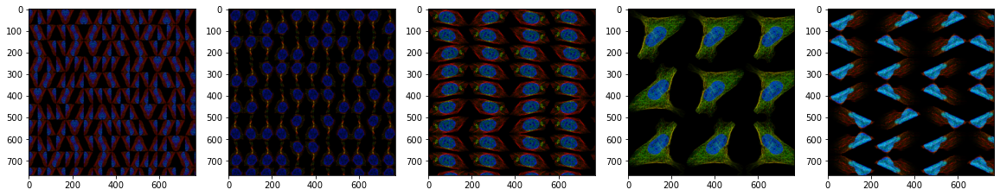

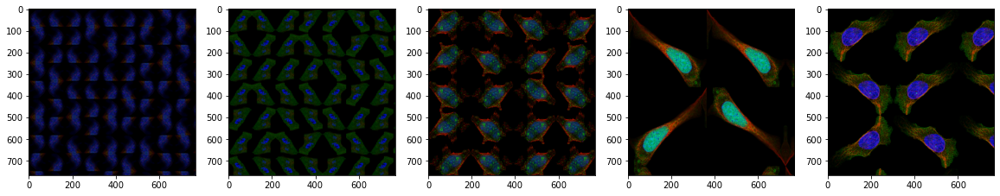

In [32]:
dataset_show = HPATestDataset(test_df, transform=transforms_grid1)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())

In [33]:
unnorm(dataset_show[9][0]).max()

tensor(0.9529)

In [34]:
dataset1 = HPATestDataset(test_df, transform=transforms_grid1)
loader1 = DataLoader(dataset1, batch_size=batch_size, num_workers=num_workers, shuffle=False)

dataset2 = HPATestDataset(test_df, transform=transforms_grid2)
loader2 = DataLoader(dataset2, batch_size=batch_size, num_workers=num_workers, shuffle=False)

dataset3 = HPATestDataset(test_df, transform=transforms_grid3)
loader3 = DataLoader(dataset3, batch_size=batch_size, num_workers=num_workers, shuffle=False)

loaders = [loader1]

In [35]:
model_dir = '.'

In [36]:
def load_models(model_files):
    models = []
    for model_f in model_files:
        model_f = os.path.join(model_dir, model_f)
        model = get_model_test()
        model.load_state_dict(torch.load(model_f, map_location=lambda storage, loc: storage), strict=True)
        model.eval()
        model.to(device)
        models.append(model)
        print(f'{model_f} loaded!')
    return models

model_files = []

epoch_eval = 3
for fold in range(nfold):
    seed = fold
    mf = f'{kernel_type}_model_seed_{seed}_fold_{fold}_epoch_{epoch_eval}.pth'
    model_files.append(mf)

models = load_models(model_files)

./bf_6_model_seed_0_fold_0_epoch_3.pth loaded!
./bf_6_model_seed_1_fold_1_epoch_3.pth loaded!
./bf_6_model_seed_2_fold_2_epoch_3.pth loaded!
./bf_6_model_seed_3_fold_3_epoch_3.pth loaded!
./bf_6_model_seed_4_fold_4_epoch_3.pth loaded!


In [37]:
ALL_FOLDS = []

with torch.no_grad():
    for model in tqdm(models):
        ALL_TTA = []
        for loader in loaders:            
            LOGITS = []
            for data in tqdm(loader):
                data = data.to(device)
                logits = model(data)
                LOGITS.append(logits)
            LOGITS = torch.cat(LOGITS).sigmoid().cpu()
            ALL_TTA.append(LOGITS)
        ALL_FOLDS.append(ALL_TTA)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/168 [00:00<?, ?it/s]

  0%|          | 0/168 [00:00<?, ?it/s]

  0%|          | 0/168 [00:00<?, ?it/s]

  0%|          | 0/168 [00:00<?, ?it/s]

  0%|          | 0/168 [00:00<?, ?it/s]

In [38]:
AVG_TTA = [sum(TTA) / len(TTA) for TTA in ALL_FOLDS]
AVG_LOGITS = sum(AVG_TTA) / len(AVG_TTA)

In [39]:
AVG_LOGITS.shape

torch.Size([10716, 19])

In [40]:
with open('logits3epochs.pickle', 'wb') as handle:
    pickle.dump(AVG_LOGITS, handle)

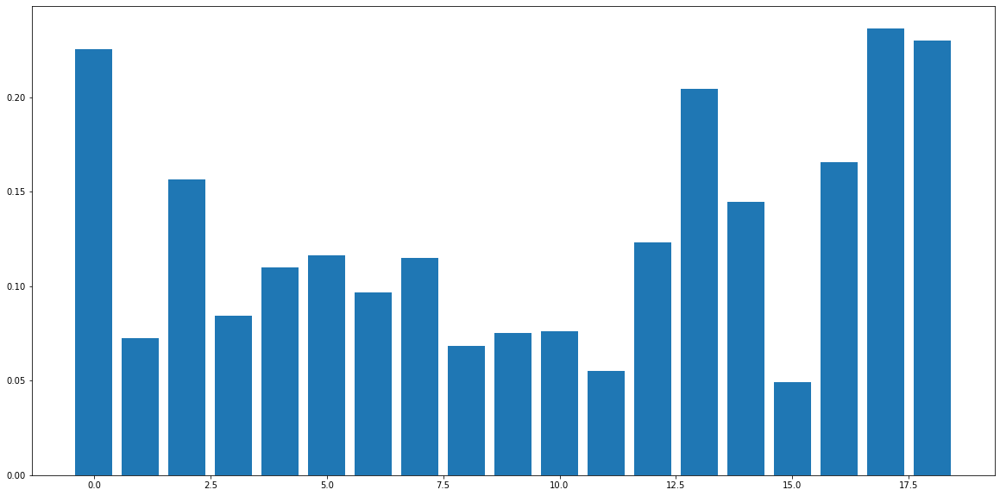

In [41]:
class_means = AVG_LOGITS.mean(dim=0).numpy()
labels = range(19)
plt.bar(labels, class_means)
plt.show()

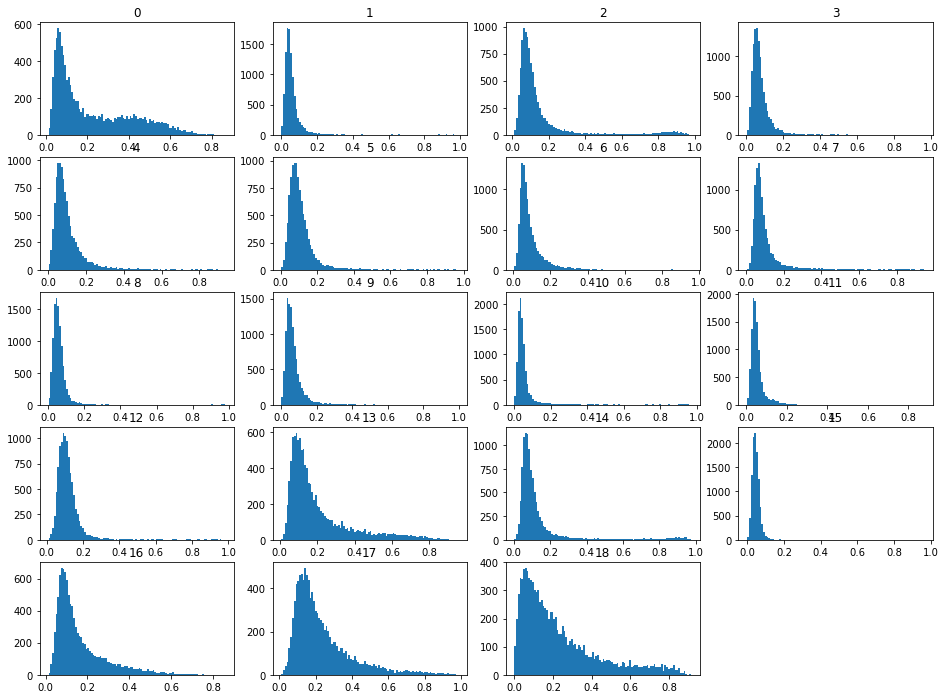

In [42]:
fig = plt.figure(figsize=(16, 12))

for i in labels:
    ax = fig.add_subplot(5,4,i+1)
    ax.hist(AVG_LOGITS[:,i].numpy(), bins=100)
    ax.set_title(i)

plt.show()

In [43]:
top_preds = AVG_LOGITS.argmax(dim=0).tolist()
top_kpreds = (-AVG_LOGITS).argsort(dim=0)[:6]
top30preds = (-AVG_LOGITS).argsort(dim=0)[30:33]
last_preds = (-AVG_LOGITS).argsort(dim=0)[-3:]
othe_preds = torch.cat([top30preds, last_preds], dim=0)
top_kvals = [[AVG_LOGITS[top_kpreds[i,j],j] for i in range(6)] for j in range(19)]
othe_vals = [[AVG_LOGITS[othe_preds[i,j],j] for i in range(6)] for j in range(19)]

In [44]:
HPA_LABEL_NAMES = {
    0: 'Nucleoplasm',
    1: 'Nuclear membrane',
    2: 'Nucleoli',
    3: 'Nucleoli fibrillar center',
    4: 'Nuclear speckles',
    5: 'Nuclear bodies',
    6: 'Endoplasmic reticulum',
    7: 'Golgi apparatus',
    8: 'Intermediate filaments',
    9: 'Actin filaments',
    10: 'Microtubules',
    11: 'Mitotic spindle',
    12: 'Centrosome',
    13: 'Plasma membrane',
    14: 'Mitochondria',
    15: 'Aggresome',
    16: 'Cytosol',
    17: 'Vesicles and punctate cytosolic patterns',
    18: 'Negative'
}

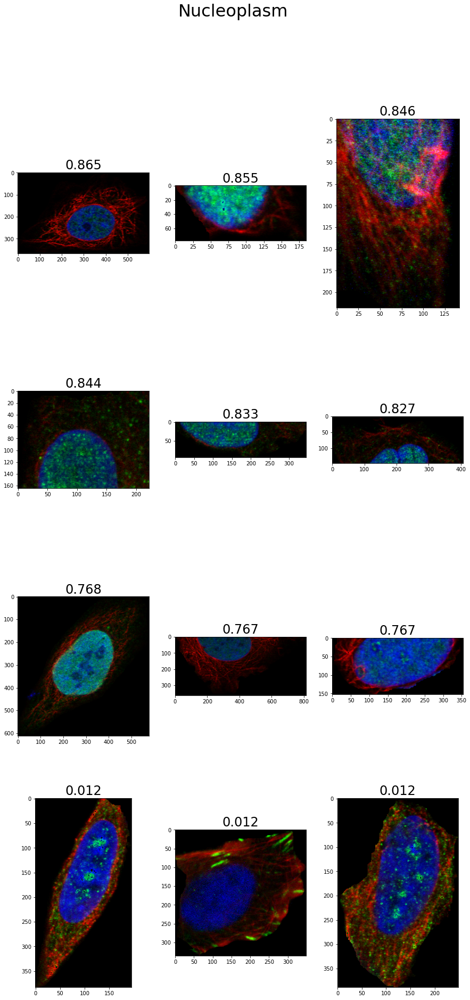

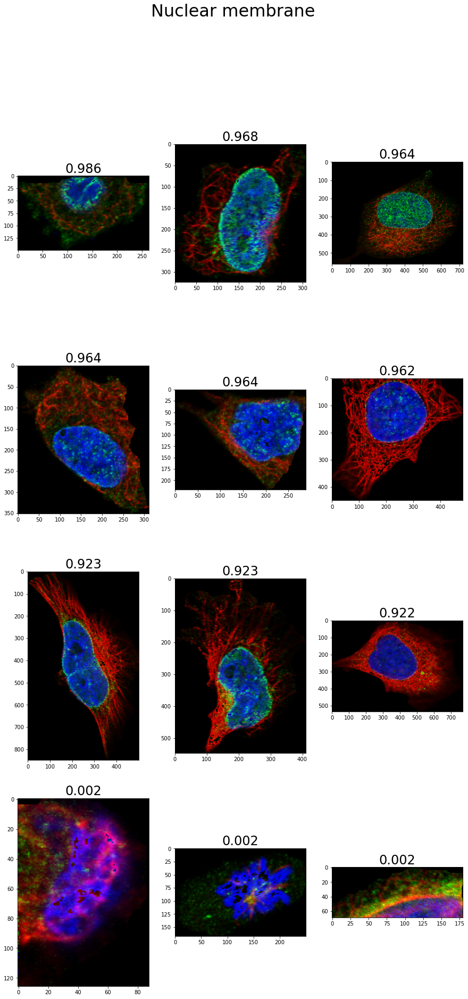

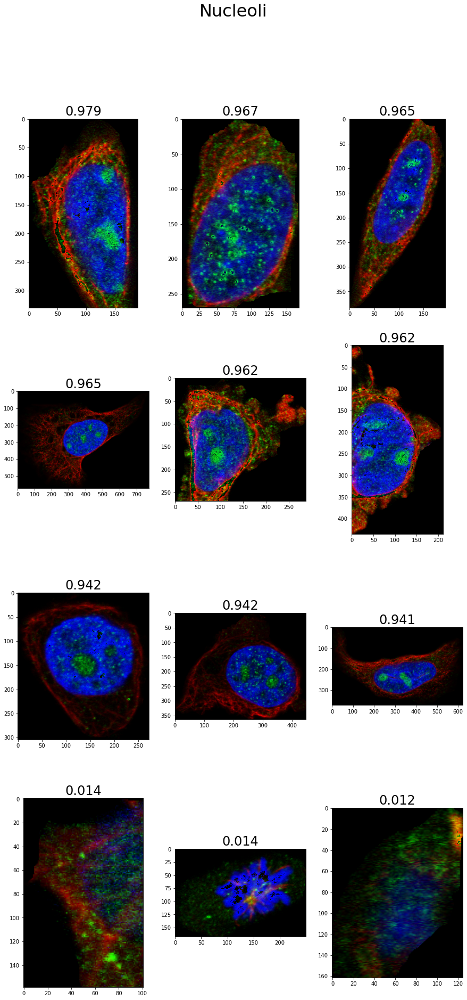

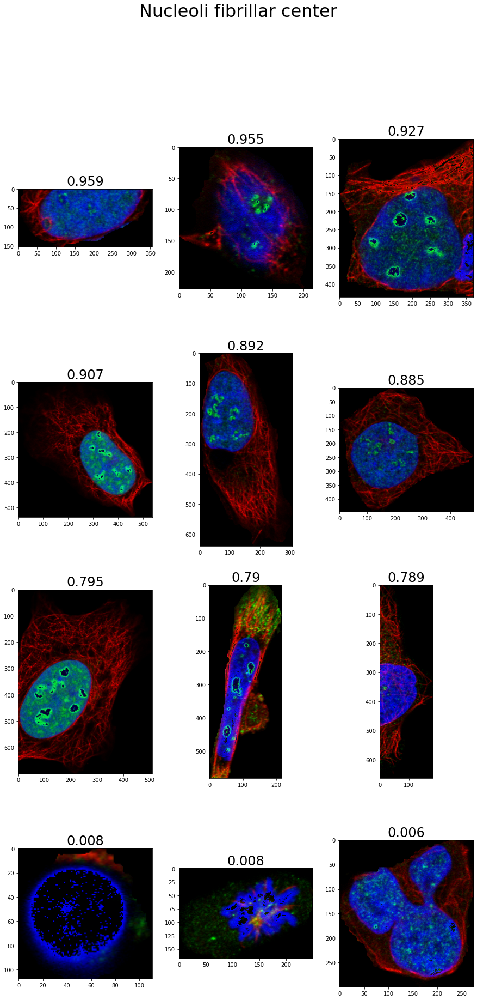

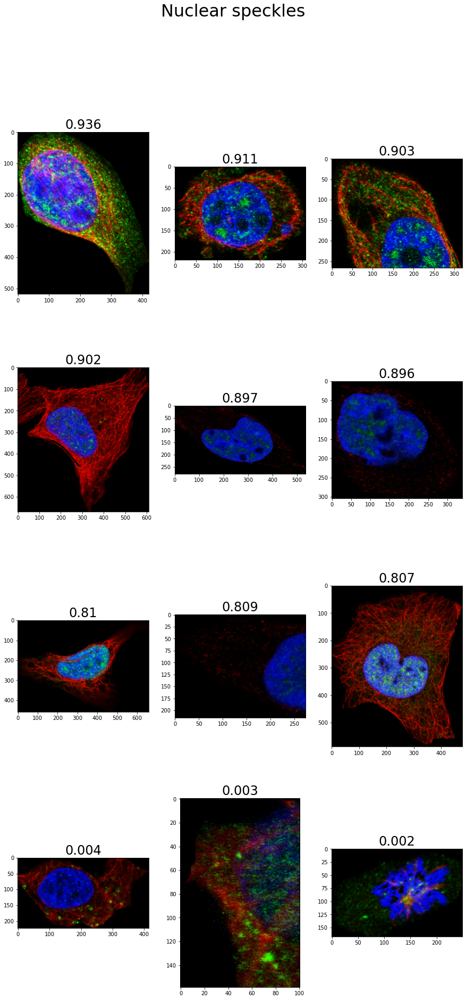

...

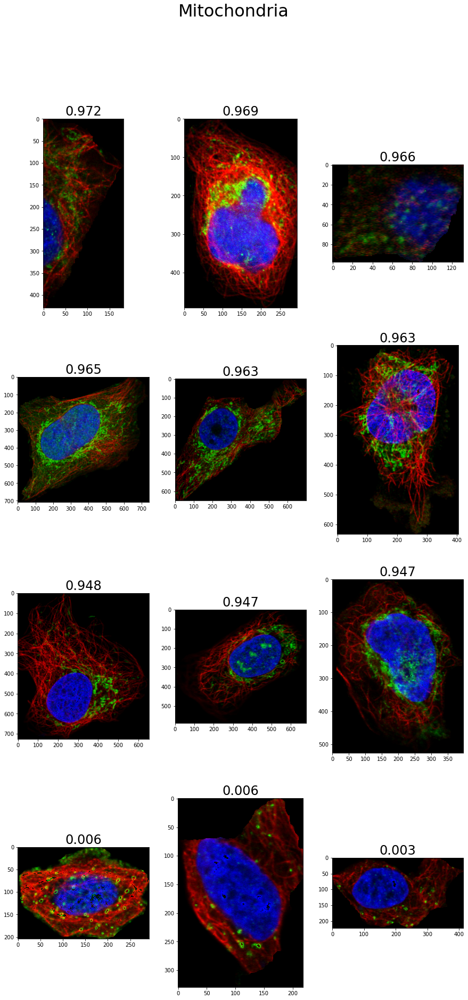

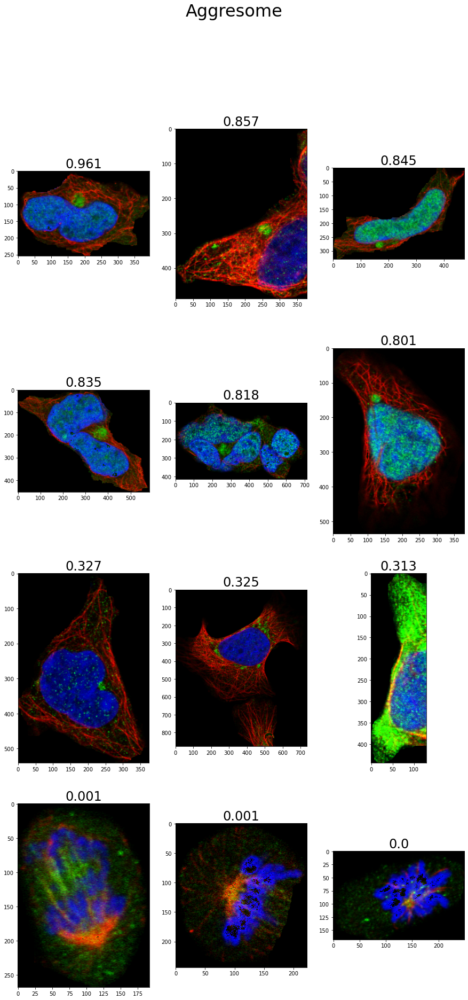

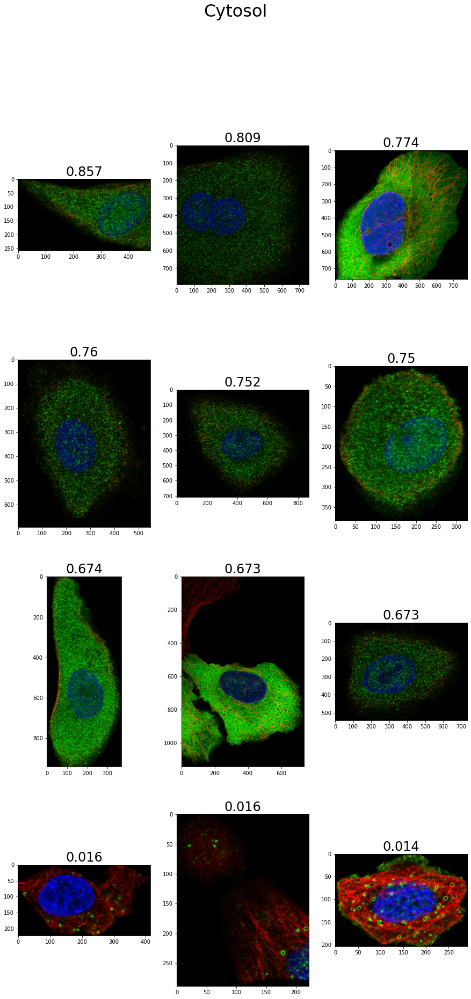

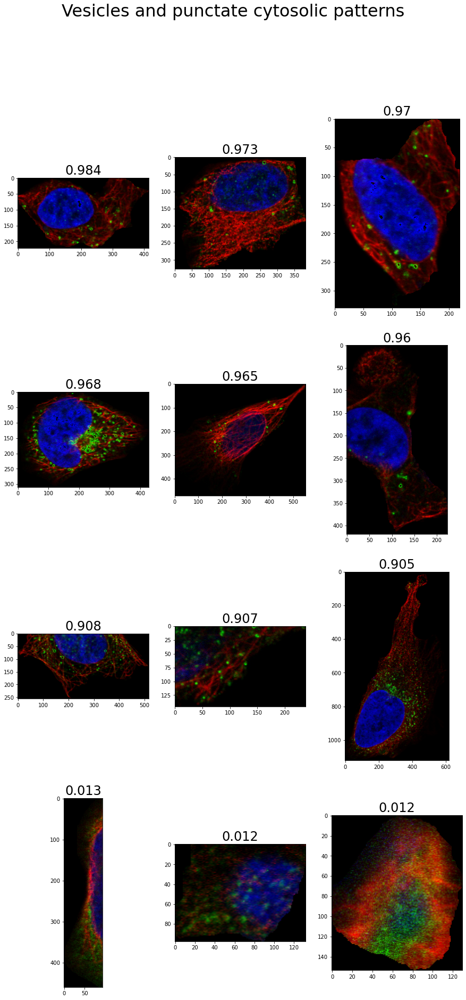

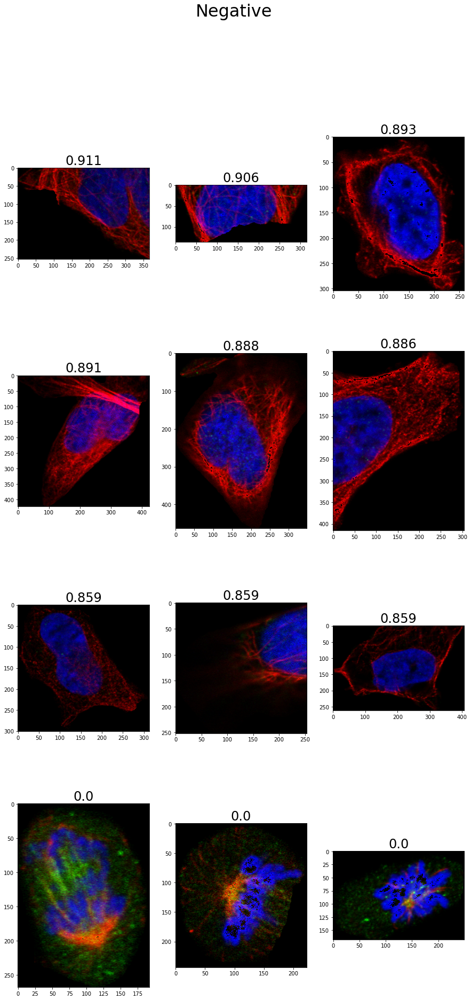

In [45]:
dataset_show = HPATestDataset(test_df, transform=None)
from pylab import rcParams
rcParams['figure.figsize'] = 15,30
rcParams['figure.titlesize'] = 32
rcParams['axes.titlesize'] = 24
rcParams['axes.labelsize'] = 20

for i in range(19):
    f, axarr = plt.subplots(4,3)
    f.suptitle(f'{HPA_LABEL_NAMES[i]}')
    for p in range(3):
        idx = top_kpreds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[0,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[0,p].title.set_text(f'{np.round(top_kvals[i][p].item(), 3)}')
    for p in range(3):
        idx = top_kpreds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[1,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[1,p].title.set_text(f'{np.round(top_kvals[i][p+3].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[2,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[2,p].title.set_text(f'{np.round(othe_vals[i][p].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[3,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[3,p].title.set_text(f'{np.round(othe_vals[i][p+3].item(), 3)}')